# INTRODUCTION

# Machine Learning: Classification - Managing the Quality Metric of Global Ecological Footprint

Logistic Regression is a Machine Learning algorithm used to make predictions to find the value of a dependent variable such as the condition of a tumor (malignant or benign), classification of email (spam or not spam), or admission into a university (admitted or not admitted) by learning from independent variables (various features relevant to the problem).

For example, for classifying an email, the algorithm will use the words in the email as features and based on that make a prediction whether the email is spam or not.

Logistic Regression is a supervised Machine Learning algorithm, which means the data provided for training is labeled i.e., answers are already provided in the training set. The algorithm learns from those examples and their corresponding answers (labels) and then uses that to classify new examples.

In mathematical terms, suppose the dependent variable is Y and the set of independent variables is X, then logistic regression will predict the dependent variable P(Y=1) as a function of X, the set of independent variables.

Logistic Regression can be divided into types based on the type of classification it does. With that in view, there are 3 types of Logistic Regression. Let’s talk about each of them:

1. Binary Logistic Regression
2. Multinomial Logistic Regression
3. Ordinal Logistic Regression

The major difference between Logistic and Linear Regression is that Linear Regression is used to solve regression problems whereas Logistic Regression is used for classification problems. In regression problems, the target variable can have continuous values such as the price of a product, the age of a participant, etc. While, the classification problems deal with the prediction of target variable that can only have discrete values, for example, prediction of gender of a person, prediction of a tumor to be malignant or benign, etc.

To perform the logistic regression we shall be performing the following:

a. Importing libraries that will be needed. Should incase the libraries aren't install we shall be using the pip installation module.

b. Performing Data importation and preprocessing

c. Perform Exploratory visualization

d. Perform model building and training

e. Perform model evaluation

f. Conclusion

# A.  LIBRARY IMPORTATION

In [1]:
import pandas as pd # data processing
import numpy as np # working with arrays
import itertools # construct specialized tools
import matplotlib.pyplot as plt # visualizations
import seaborn as sns
from matplotlib import rcParams # plot size customization
from termcolor import colored as cl # text customization
from sklearn.model_selection import train_test_split # splitting the data
from sklearn.linear_model import LogisticRegression # model algorithm
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler # data normalization
from sklearn.metrics import jaccard_score  # evaluation metric
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.metrics import precision_score # evaluation metric
from sklearn.metrics import classification_report # evaluation metric
from sklearn.metrics import confusion_matrix # evaluation metric
from sklearn.metrics import log_loss # evaluation metric

rcParams['figure.figsize'] = (20, 10)


# B.  DATA IMPORTATION AND PREPROCESSING

In [2]:
## Load data set
df = pd.read_csv("C:/Users/IZZYLYF/OneDrive/hamoyeGIT/Machine Learning Classification - Managing the Quality Metric of Global Ecological Footprint\elecgrid.csv")

Data has been read and read as 'df'. The data we are working with is of dimension 10000 rows and 14 features recorded as columns. A statistical description of the data set shows that 'stabf' is a factor variable of twol levels: Stable and Unstable. The entire data set are unique in their value recordings with thirteen float varaibles and one object variable. The data set is 100% complete with no missling, null or duplicate. The target varaible 'stabf' has 6380 unstable records and 3620 stable records. The 'stab' feature will be droped as it is directly related to the target varaible.
    

In [3]:
print(df.shape)

(10000, 14)


In [4]:
print (df.describe)

<bound method NDFrame.describe of           tau1      tau2      tau3      tau4        p1        p2        p3  \
0     2.959060  3.079885  8.381025  9.780754  3.763085 -0.782604 -1.257395   
1     9.304097  4.902524  3.047541  1.369357  5.067812 -1.940058 -1.872742   
2     8.971707  8.848428  3.046479  1.214518  3.405158 -1.207456 -1.277210   
3     0.716415  7.669600  4.486641  2.340563  3.963791 -1.027473 -1.938944   
4     3.134112  7.608772  4.943759  9.857573  3.525811 -1.125531 -1.845975   
...        ...       ...       ...       ...       ...       ...       ...   
9995  2.930406  9.487627  2.376523  6.187797  3.343416 -0.658054 -1.449106   
9996  3.392299  1.274827  2.954947  6.894759  4.349512 -1.663661 -0.952437   
9997  2.364034  2.842030  8.776391  1.008906  4.299976 -1.380719 -0.943884   
9998  9.631511  3.994398  2.757071  7.821347  2.514755 -0.966330 -0.649915   
9999  6.530527  6.781790  4.349695  8.673138  3.492807 -1.390285 -1.532193   

            p4        g1     

In [5]:
print(sorted(df)) 

['g1', 'g2', 'g3', 'g4', 'p1', 'p2', 'p3', 'p4', 'stab', 'stabf', 'tau1', 'tau2', 'tau3', 'tau4']


In [6]:
print(df.nunique())  

tau1     10000
tau2     10000
tau3     10000
tau4     10000
p1       10000
p2       10000
p3       10000
p4       10000
g1       10000
g2       10000
g3       10000
g4       10000
stab     10000
stabf        2
dtype: int64


In [7]:
df.head()

,tau1,tau2,tau3,tau4,p1,p2,p3,p4,g1,g2,g3,g4,stab,stabf
0,2.959060,3.079885,8.381025,9.780754,3.763085,-0.782604,-1.257395,-1.723086,0.650456,0.859578,0.887445,0.958034,0.055347,unstable
1,9.304097,4.902524,3.047541,1.369357,5.067812,-1.940058,-1.872742,-1.255012,0.413441,0.862414,0.562139,0.781760,-0.005957,stable
2,8.971707,8.848428,3.046479,1.214518,3.405158,-1.207456,-1.277210,-0.920492,0.163041,0.766689,0.839444,0.109853,0.003471,unstable
3,0.716415,7.669600,4.486641,2.340563,3.963791,-1.027473,-1.938944,-0.997374,0.446209,0.976744,0.929381,0.362718,0.028871,unstable
4,3.134112,7.608772,4.943759,9.857573,3.525811,-1.125531,-1.845975,-0.554305,0.797110,0.455450,0.656947,0.820923,0.049860,unstable


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   tau1    10000 non-null  float64
 1   tau2    10000 non-null  float64
 2   tau3    10000 non-null  float64
 3   tau4    10000 non-null  float64
 4   p1      10000 non-null  float64
 5   p2      10000 non-null  float64
 6   p3      10000 non-null  float64
 7   p4      10000 non-null  float64
 8   g1      10000 non-null  float64
 9   g2      10000 non-null  float64
 10  g3      10000 non-null  float64
 11  g4      10000 non-null  float64
 12  stab    10000 non-null  float64
 13  stabf   10000 non-null  object 
dtypes: float64(13), object(1)
memory usage: 1.1+ MB


In [9]:
sum(df.duplicated())

0

In [10]:
#to determine the missing entries
df.isnull()

,tau1,tau2,tau3,tau4,p1,p2,p3,p4,g1,g2,g3,g4,stab,stabf
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,False,False,False,False,False,False,False,False,False,False,False,False,False,False
9996,False,False,False,False,False,False,False,False,False,False,False,False,False,False
9997,False,False,False,False,False,False,False,False,False,False,False,False,False,False
9998,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [11]:
# Count total NaN at each column in a DataFrame
print(" \nCount total NaN at each column in a DataFrame : \n\n",
      df.isnull().sum())

 
Count total NaN at each column in a DataFrame : 

 tau1     0
tau2     0
tau3     0
tau4     0
p1       0
p2       0
p3       0
p4       0
g1       0
g2       0
g3       0
g4       0
stab     0
stabf    0
dtype: int64


In [12]:
#drop features closely related to the target feature
df.drop('stab',  axis='columns', inplace=True)

In [13]:
#check distribution of target variable
df['stabf'].value_counts()

unstable    6380
stable      3620
Name: stabf, dtype: int64

In [14]:
#df.hist(figsize=(14,14), xrot=45)
#plt.show()#drop stab columns
#df.drop('Unnamed: 0', axis = 1, inplace = True)
#df.drop('stab',  axis='columns', inplace=True)

In [15]:
print(df.shape)

(10000, 13)


# C. PERFORM EXPLORATORY VISUALIZATION

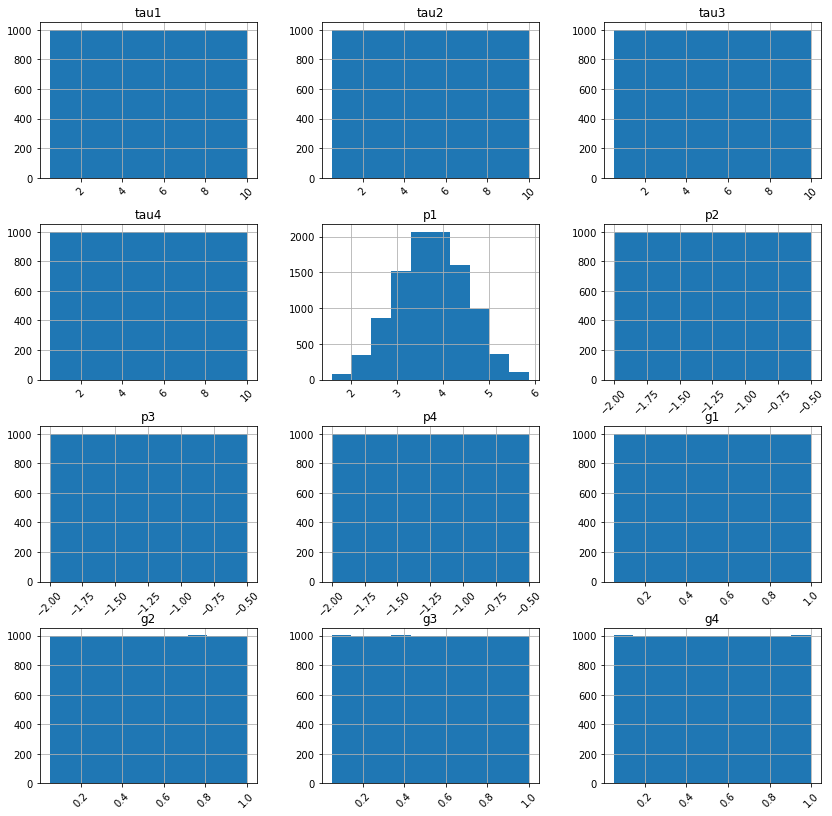

In [16]:
df.hist(figsize=(14,14), xrot=45)
plt.show()

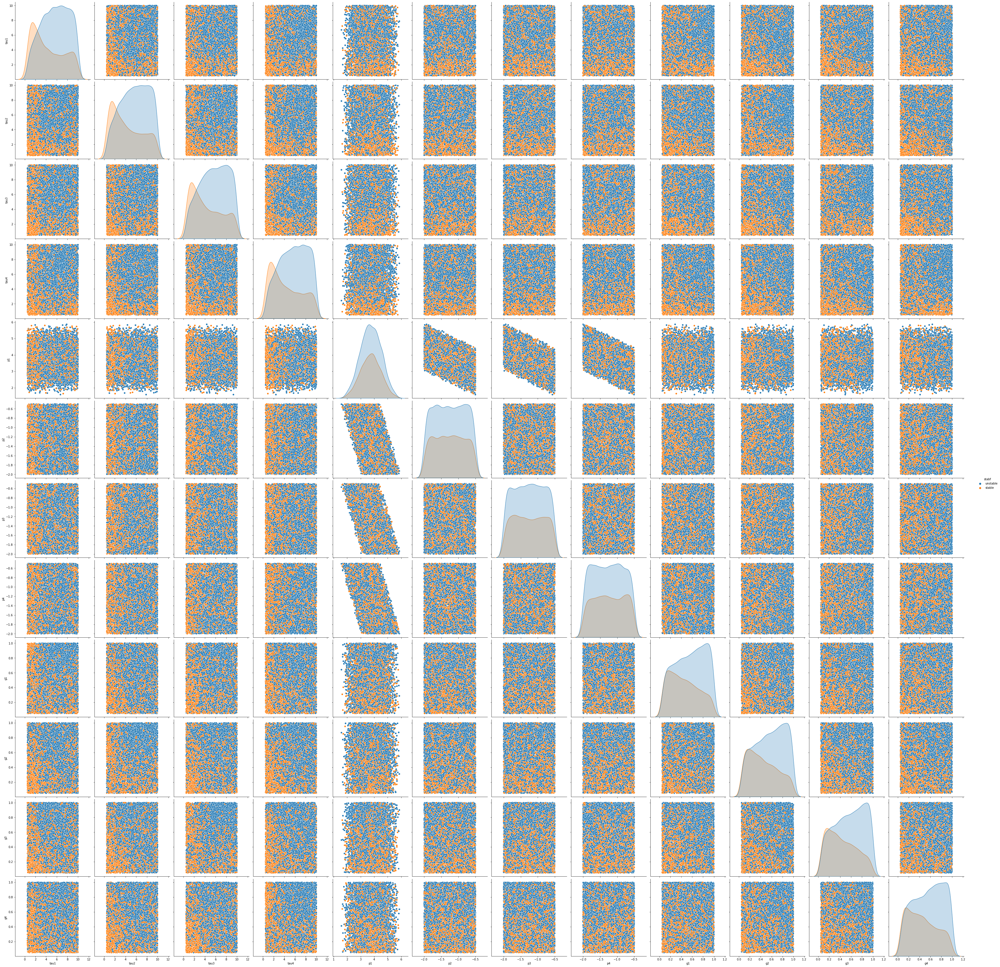

In [17]:
sns.pairplot(df,hue='stabf',height=4)

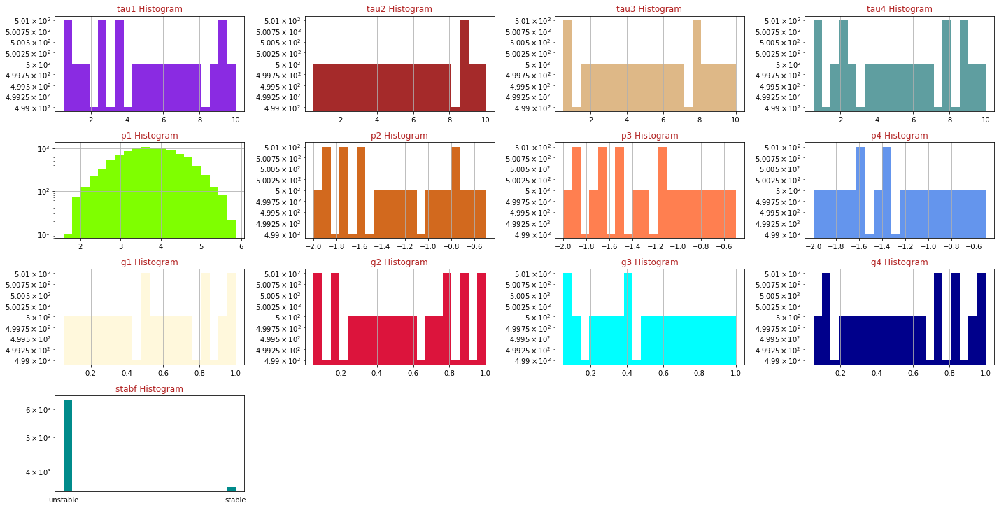

In [18]:
import matplotlib.colors as mcolors
colors = list(mcolors.CSS4_COLORS.keys())[10:]
def draw_histograms(dataframe, features, rows, cols):
    fig=plt.figure(figsize=(20,20))
    for i, feature in enumerate(features):
        ax=fig.add_subplot(rows,cols,i+1)
        dataframe[feature].hist(bins=20,ax=ax,facecolor=colors[i])
        ax.set_title(feature+" Histogram",color=colors[35])
        ax.set_yscale('log')
    fig.tight_layout() 
    plt.savefig('Histograms.png')
    plt.show()
draw_histograms(df,df.columns,8,4)

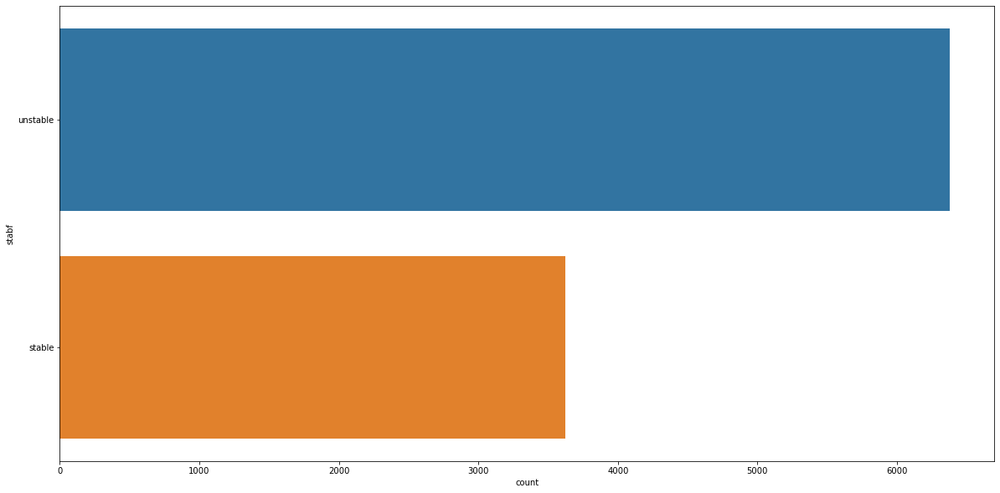

In [19]:
#plot categorical feature
sns.countplot(y='stabf', data=df)
plt.show()

In [20]:
cordf= df.corr()
cordf

,tau1,tau2,tau3,tau4,p1,p2,p3,p4,g1,g2,g3,g4
tau1,1.000000,0.015586,-0.005970,-0.017265,0.027183,-0.015485,-0.015924,-0.015807,0.010521,0.015350,-0.001279,0.005494
tau2,0.015586,1.000000,0.014273,-0.001965,-0.004769,0.006573,0.007673,-0.005963,-0.001742,0.015383,0.016508,-0.011764
tau3,-0.005970,0.014273,1.000000,0.004354,0.016953,-0.003134,-0.008780,-0.017531,-0.011605,0.007671,0.014702,-0.011497
tau4,-0.017265,-0.001965,0.004354,1.000000,-0.003173,0.010553,0.006169,-0.011211,-0.004149,0.008431,0.003260,-0.000491
p1,0.027183,-0.004769,0.016953,-0.003173,1.000000,-0.573157,-0.584554,-0.579239,0.000721,0.015405,0.001069,-0.015451
p2,-0.015485,0.006573,-0.003134,0.010553,-0.573157,1.000000,0.002388,-0.006844,0.015603,-0.018032,0.007555,0.019817
p3,-0.015924,0.007673,-0.008780,0.006169,-0.584554,0.002388,1.000000,0.012953,-0.003219,-0.011575,-0.005897,-0.010485
p4,-0.015807,-0.005963,-0.017531,-0.011211,-0.579239,-0.006844,0.012953,1.000000,-0.013636,0.002850,-0.003515,0.017505
g1,0.010521,-0.001742,-0.011605,-0.004149,0.000721,0.015603,-0.003219,-0.013636,1.000000,0.007559,-0.005836,0.012431
g2,0.015350,0.015383,0.007671,0.008431,0.015405,-0.018032,-0.011575,0.002850,0.007559,1.000000,-0.012809,-0.014909


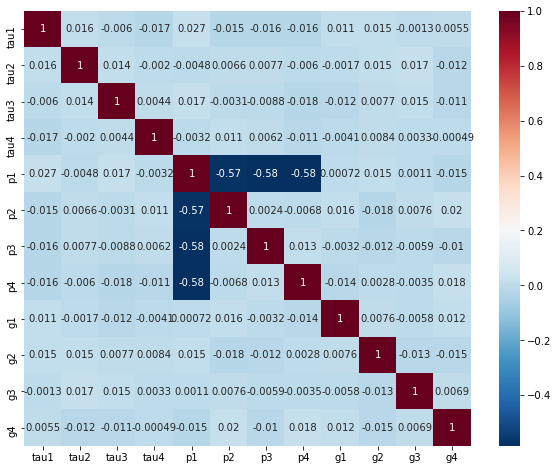

In [21]:
plt.figure(figsize=(10,8))
sns.heatmap(cordf, cmap='RdBu_r', annot=True)
plt.show()

## D.  MODEL BUILDING AND TRAINING

In performing the model building, we will split the data into train and test at 80-20 and scale the train set. Also observing our data exploration and visulaization we observe that we are dealing with a binary logistic regression. From the visualization, the features are uniformly distributed, hence the need to scale by transformation.

In [22]:
# Splitting data into feature and target varaible
x=df.iloc[:,df.columns != 'stabf']
y = df.stabf

In [23]:
## taking a glimpse of the split
print(cl('x samples : ', attrs = ['bold']), x[:5])
print(cl('y samples : ', attrs = ['bold']), y[:5])

x samples :         tau1      tau2      tau3      tau4        p1        p2        p3  \
0  2.959060  3.079885  8.381025  9.780754  3.763085 -0.782604 -1.257395   
1  9.304097  4.902524  3.047541  1.369357  5.067812 -1.940058 -1.872742   
2  8.971707  8.848428  3.046479  1.214518  3.405158 -1.207456 -1.277210   
3  0.716415  7.669600  4.486641  2.340563  3.963791 -1.027473 -1.938944   
4  3.134112  7.608772  4.943759  9.857573  3.525811 -1.125531 -1.845975   

         p4        g1        g2        g3        g4  
0 -1.723086  0.650456  0.859578  0.887445  0.958034  
1 -1.255012  0.413441  0.862414  0.562139  0.781760  
2 -0.920492  0.163041  0.766689  0.839444  0.109853  
3 -0.997374  0.446209  0.976744  0.929381  0.362718  
4 -0.554305  0.797110  0.455450  0.656947  0.820923  
y samples :  0    unstable
1      stable
2    unstable
3    unstable
4    unstable
Name: stabf, dtype: object


In [24]:
## Splitting data into train and test
x_train, x_test, y_train, y_test = train_test_split(
x, y, test_size=0.20, random_state=1, stratify=y)

In [25]:
## Scalling the training set
scaler = preprocessing.StandardScaler().fit(x_train, x_test)
x_train_scaled = scaler.transform(x_train)
x_test_scaled = scaler.transform(x_test)


In [26]:
## Building the Logistic regression
logmod = LogisticRegression()

In [27]:
## Training the model
logmod.fit(x_train_scaled, y_train)

LogisticRegression()

In [28]:
##training model evaluation
Accutrain = logmod.score(x_train_scaled, y_train)
print("Training model accuaracy is {}".format(Accutrain*100))

Training model accuaracy is 81.66250000000001


In [29]:
## Perform predictions
ypred = logmod.predict(x_test_scaled)
prob_ypred = logmod.predict_proba(x_test_scaled)

print(cl('samples of ypred : ', attrs = ['bold']), ypred[:15])
print(cl('samples of prob_ypred : ', attrs = ['bold']), prob_ypred[:15])

samples of ypred :  ['stable' 'stable' 'stable' 'unstable' 'unstable' 'unstable' 'unstable'
 'unstable' 'unstable' 'stable' 'unstable' 'unstable' 'unstable'
 'unstable' 'stable']
samples of prob_ypred :  [[0.72045669 0.27954331]
 [0.91374982 0.08625018]
 [0.78048555 0.21951445]
 [0.35963995 0.64036005]
 [0.03681823 0.96318177]
 [0.02319721 0.97680279]
 [0.00518588 0.99481412]
 [0.25408509 0.74591491]
 [0.00534455 0.99465545]
 [0.73128251 0.26871749]
 [0.29851582 0.70148418]
 [0.00156819 0.99843181]
 [0.42037315 0.57962685]
 [0.0575002  0.9424998 ]
 [0.92808403 0.07191597]]


## MODEL EVALUATION

In [30]:
#Model evaluation on test data
Accutest= accuracy_score(y_test, ypred)
print("Test Set is {}".format(Accutest*100))

Test Set is 81.15


In [31]:
### Classification report
print(classification_report(y_test, ypred))

              precision    recall  f1-score   support

      stable       0.76      0.69      0.73       724
    unstable       0.83      0.88      0.86      1276

    accuracy                           0.81      2000
   macro avg       0.80      0.79      0.79      2000
weighted avg       0.81      0.81      0.81      2000



In [32]:
# make the confusion matrix for evaluation
confusion_matrix(y_test, ypred)

array([[ 502,  222],
       [ 155, 1121]], dtype=int64)

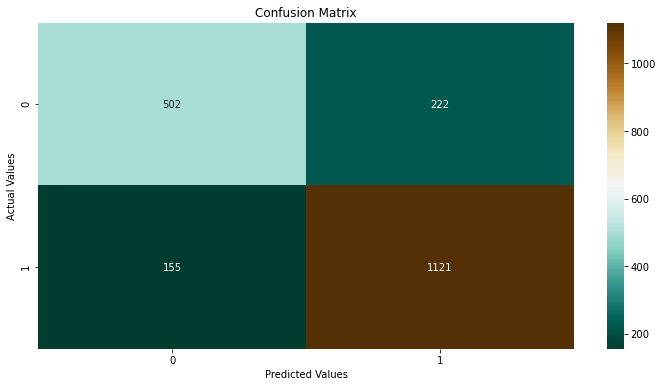

In [33]:
#visualizing the confusion matrix
logcm=confusion_matrix(y_test,ypred)
plt.figure(figsize=(12,6))
plt.title("Confusion Matrix")
sns.heatmap(logcm, annot=True,fmt='d', cmap='BrBG_r')
plt.ylabel("Actual Values")
plt.xlabel("Predicted Values")
plt.savefig('confusion_matrix_logregres.png')

In [34]:
 ## Precision Score
print(cl('Precision Score of our model is {}'.format(precision_score(y_test, ypred, pos_label='stable')), attrs = ['bold']))

Precision Score of our model is 0.7640791476407914


In [35]:
# Log loss: n/b i used the predicted probability of the ypred
print(cl('Log loss of the model is {}'.format(log_loss(y_test, prob_ypred).round(2)), attrs = ['bold']))

Log loss of the model is 0.4


## RANDOM FOREST CLASSIFIER

Random forests is a supervised learning algorithm which is used for classification and regression. It is flexible and easy to use algorithm that creates decision trees on randomly selected data samples, gets prediction from each tree and selects the best solution by means of voting. It gives a good indicator of the feature importance. Random forests has various applications to include recommendation engines, image classification and feature selection.



In [36]:
##import necessary libraries
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.ensemble import RandomForestClassifier

In [ ]:
#RANDOM FOREST FOR N=100

In [37]:
# creating a RF classifier  ##x_train_scaled, x_test_scaled
rfcl = RandomForestClassifier(n_estimators = 100,
                             bootstrap = True,
                               max_features = 'sqrt')

In [38]:
# Training the model on the training dataset
# fit function is used to train the model using the training sets as parameters
rfcl.fit(x_train_scaled, y_train)

RandomForestClassifier(max_features='sqrt')

In [39]:
# performing predictions on the test dataset
rfypred = rfcl.predict(x_test_scaled)

In [40]:
# Probabilities for each class
rfcl_probs = rfcl.predict_proba(x_test_scaled)[:, 1]

In [50]:
# metrics are used to find accuracy or error
from sklearn import metrics
print()

In [51]:
# using metrics module for accuracy calculation
print("Model accuracy: ", metrics.accuracy_score(y_test, rfypred))

Model accuracy:  0.9195


In [52]:
from sklearn.metrics import roc_auc_score

# Calculate roc auc
rocvalue = roc_auc_score(y_test, rfcl_probs)
rocvalue

0.9800627608722008

## RF FOR N=50

In [55]:
# creating a RF classifier  ##x_train_scaled, x_test_scaled
rfcl1 = RandomForestClassifier(n_estimators = 50,
                             bootstrap = True,
                               max_features = 'sqrt')

In [56]:
rfcl1.fit(x_train_scaled, y_train)

RandomForestClassifier(max_features='sqrt', n_estimators=50)

In [57]:
# performing predictions on the test dataset
rfypred1 = rfcl1.predict(x_test_scaled)

In [58]:
# Probabilities for each class
rfcl1_probs = rfcl1.predict_proba(x_test_scaled)[:, 1]

In [59]:
# using metrics module for accuracy calculation
print("Model accuracy: ", metrics.accuracy_score(y_test, rfypred1))

Model accuracy:  0.9145


In [60]:
# Calculate roc auc
rocvalue1 = roc_auc_score(y_test, rfcl1_probs)
rocvalue1

0.9767553127002546

## RF FOR N=300

In [64]:
# creating a RF classifier  ##x_train_scaled, x_test_scaled
rfcl2 = RandomForestClassifier(n_estimators = 300,
                             bootstrap = True,
                               max_features = 'sqrt')

rfcl2.fit(x_train_scaled, y_train)

# performing predictions on the test dataset
rfypred2 = rfcl2.predict(x_test_scaled)

# Probabilities for each class
rfcl2_probs = rfcl2.predict_proba(x_test_scaled)[:, 1]


# using metrics module for accuracy calculation
print("Model accuracy: ", metrics.accuracy_score(y_test, rfypred2))

# Calculate roc auc
rocvalue2 = roc_auc_score(y_test, rfcl2_probs)
print("ROC value: ", rocvalue2)

Model accuracy:  0.9165
ROC value:  0.9804968262353002


## RF FOR N=500

In [65]:
# creating a RF classifier  ##x_train_scaled, x_test_scaled
rfcl3 = RandomForestClassifier(n_estimators = 500,
                             bootstrap = True,
                               max_features = 'sqrt')

rfcl3.fit(x_train_scaled, y_train)

# performing predictions on the test dataset
rfypred3 = rfcl3.predict(x_test_scaled)

# Probabilities for each class
rfcl3_probs = rfcl3.predict_proba(x_test_scaled)[:, 1]

# using metrics module for accuracy calculation
print("Model accuracy: ", metrics.accuracy_score(y_test, rfypred3))

# Calculate roc auc
rocvalue3 = roc_auc_score(y_test, rfcl3_probs)
print("ROC value: ", rocvalue3)

Model accuracy:  0.918
ROC value:  0.9808529546753495


## RF FOR N=1000

In [66]:
# creating a RF classifier  ##x_train_scaled, x_test_scaled
rfcl4 = RandomForestClassifier(n_estimators = 1000,
                             bootstrap = True,
                               max_features = 'sqrt')

rfcl4.fit(x_train_scaled, y_train)

# performing predictions on the test dataset
rfypred4 = rfcl4.predict(x_test_scaled)

# Probabilities for each class
rfcl4_probs = rfcl4.predict_proba(x_test_scaled)[:, 1]

# using metrics module for accuracy calculation
print("Model accuracy: ", metrics.accuracy_score(y_test, rfypred4))

# Calculate roc auc
rocvalue4 = roc_auc_score(y_test, rfcl4_probs)
print("ROC value: ", rocvalue4)

Model accuracy:  0.9195
ROC value:  0.9809909679765842


## Algorithm evaluation

In [68]:
# for n=100
print(confusion_matrix(y_test,rfypred))
print(classification_report(y_test,rfypred))
print(accuracy_score(y_test, rfypred))

[[ 617  107]
 [  54 1222]]
              precision    recall  f1-score   support

      stable       0.92      0.85      0.88       724
    unstable       0.92      0.96      0.94      1276

    accuracy                           0.92      2000
   macro avg       0.92      0.90      0.91      2000
weighted avg       0.92      0.92      0.92      2000

0.9195


In [70]:
#for n=50
print(confusion_matrix(y_test,rfypred1))
print(classification_report(y_test,rfypred1))
print(accuracy_score(y_test, rfypred1))

[[ 617  107]
 [  64 1212]]
              precision    recall  f1-score   support

      stable       0.91      0.85      0.88       724
    unstable       0.92      0.95      0.93      1276

    accuracy                           0.91      2000
   macro avg       0.91      0.90      0.91      2000
weighted avg       0.91      0.91      0.91      2000

0.9145


In [71]:
#for n=300
print(confusion_matrix(y_test,rfypred2))
print(classification_report(y_test,rfypred2))
print(accuracy_score(y_test, rfypred2))

[[ 613  111]
 [  56 1220]]
              precision    recall  f1-score   support

      stable       0.92      0.85      0.88       724
    unstable       0.92      0.96      0.94      1276

    accuracy                           0.92      2000
   macro avg       0.92      0.90      0.91      2000
weighted avg       0.92      0.92      0.92      2000

0.9165


In [72]:
#for n=500
print(confusion_matrix(y_test,rfypred3))
print(classification_report(y_test,rfypred3))
print(accuracy_score(y_test, rfypred3))

[[ 613  111]
 [  53 1223]]
              precision    recall  f1-score   support

      stable       0.92      0.85      0.88       724
    unstable       0.92      0.96      0.94      1276

    accuracy                           0.92      2000
   macro avg       0.92      0.90      0.91      2000
weighted avg       0.92      0.92      0.92      2000

0.918


In [73]:
#for n=1000
print(confusion_matrix(y_test,rfypred4))
print(classification_report(y_test,rfypred4))
print(accuracy_score(y_test, rfypred4))

[[ 611  113]
 [  48 1228]]
              precision    recall  f1-score   support

      stable       0.93      0.84      0.88       724
    unstable       0.92      0.96      0.94      1276

    accuracy                           0.92      2000
   macro avg       0.92      0.90      0.91      2000
weighted avg       0.92      0.92      0.92      2000

0.9195


### EXTRA TREE CLASSIFIER

In [74]:
### Load required libraries
import matplotlib.pyplot as plt
from sklearn.ensemble import ExtraTreesClassifier

In [83]:
# Building the model
extrcls = ExtraTreesClassifier(n_estimators = 1000, min_samples_split =  9, 
                               min_samples_leaf =  8,
                               criterion ='entropy', max_features = 'auto')



In [84]:
# Training the model
extrcls.fit(x, y)

ExtraTreesClassifier(criterion='entropy', min_samples_leaf=8,
                     min_samples_split=9, n_estimators=1000)

In [85]:
# Computing the importance of each feature
Extrfeatureimpt = extrcls.feature_importances_

# Normalizing the individual importances
EXfeatureimpt_normalized = np.std([tree.feature_importances_ for tree in 
                                      extrcls.estimators_], axis = 0)

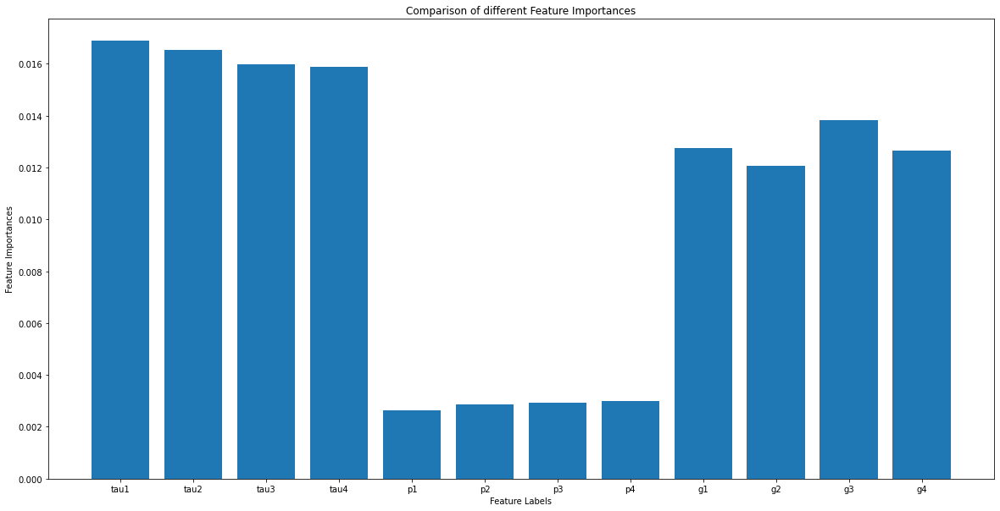

In [86]:
# Plotting a Bar Graph to compare the models
plt.bar(x.columns, EXfeatureimpt_normalized)
plt.xlabel('Feature Labels')
plt.ylabel('Feature Importances')
plt.title('Comparison of different Feature Importances')
plt.show()


In [96]:
## QUESTION 17

extr = ExtraTreesClassifier(n_estimators=100, criterion='gini', 
                             min_samples_split=2, 
                               min_samples_leaf=1, bootstrap=True,
                               max_features='auto', max_leaf_nodes=9, 
                               oob_score='accuracy', n_jobs=-1, random_state=1, 
                               verbose=1)

In [97]:
extr.fit(x,y)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    1.7s finished


ExtraTreesClassifier(bootstrap=True, max_leaf_nodes=9, n_jobs=-1,
                     oob_score='accuracy', random_state=1, verbose=1)

In [98]:
# Computing the importance of each feature
extr_featureimpt = extr.feature_importances_

# Normalizing the individual importances
exfeatureimpt_normalized = np.std([tree.feature_importances_ for tree in 
                                      extr.estimators_], axis = 0)

In [99]:
print(extr_featureimpt)

[1.51200755e-01 1.53695644e-01 1.46987307e-01 1.69770988e-01
 8.19305751e-05 0.00000000e+00 0.00000000e+00 0.00000000e+00
 8.57710403e-02 1.07082822e-01 1.06569316e-01 7.88401963e-02]


In [100]:
print(exfeatureimpt_normalized)

[0.14177862 0.13957409 0.13828536 0.1494453  0.0008152  0.
 0.         0.         0.09506063 0.11361426 0.11508708 0.07964493]


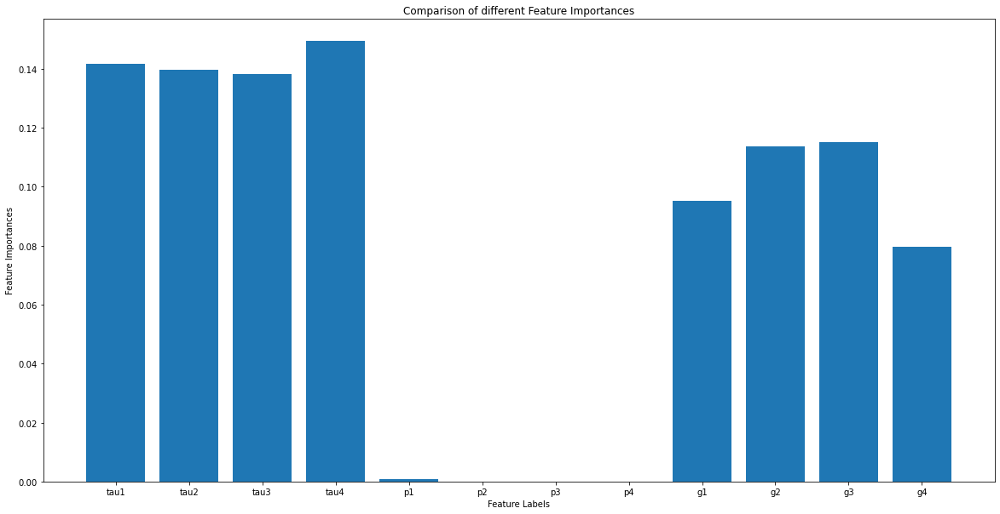

In [101]:
# Plotting a Bar Graph to compare the models
plt.bar(x.columns, exfeatureimpt_normalized)
plt.xlabel('Feature Labels')
plt.ylabel('Feature Importances')
plt.title('Comparison of different Feature Importances')
plt.show()
